# Reef Check 

[Reef Check](https://www.reefcheck.org/) is a nonprofit organization dedicated to saving our reefs and oceans. They have collected ocean temperature data at a number of sites along the West coast of USA. 

This is an initial exploration of that data. I will expand this notebook as I go.

In [1]:
import glob
import os
import pandas as pd
import plotly.express as px

import reef_check as reef_check
import graphs as graphs
import importlib

import plotly.io as pio
from plotly.offline import init_notebook_mode

pio.renderers.default = "notebook_connected"
init_notebook_mode(connected=True)

Pick a location that has data from several years and read the csv files in that directory

In [2]:
data_dir = '/Users/jenny.folkesson/Data/reef_check/'

There can be data fluctuations at the beginning and end of the time series, perhaps due to the device being activated before being placed in the water, and/or taken out of the water before being deactivated. 
In case there's no knowledge of when the device was deployed and retrieved, change point detection can be performed for the first and last 14 days of data in each time series and if change points are detected, the time series is cropped to remove dubious data. Below is an example of change point detection.

For most of the data, this is not necessary because there is a file named 'HOBO_deployment_metadata.csv' which lists all times of deployment and retreival of devices for each site. 

In [3]:
# Pick 'Little Corona'
site_name = 'Little Corona'
site_dir = os.path.join(data_dir, 'Southern California/Little Corona/')
file_paths = glob.glob(os.path.join(site_dir, '*.csv'))
file_paths.sort()
temp_data = pd.read_csv(file_paths[1], skiprows=1)
temp_data = reef_check.format_data(temp_data)
temp_data = reef_check.change_point_detection(temp_data, debug=True)

Now read all the time series in the directory.

In [4]:
temp_data = reef_check.site_temperature(data_dir, site_name, resample_rate='d')

Plot montly temperatures across each year in the data set.

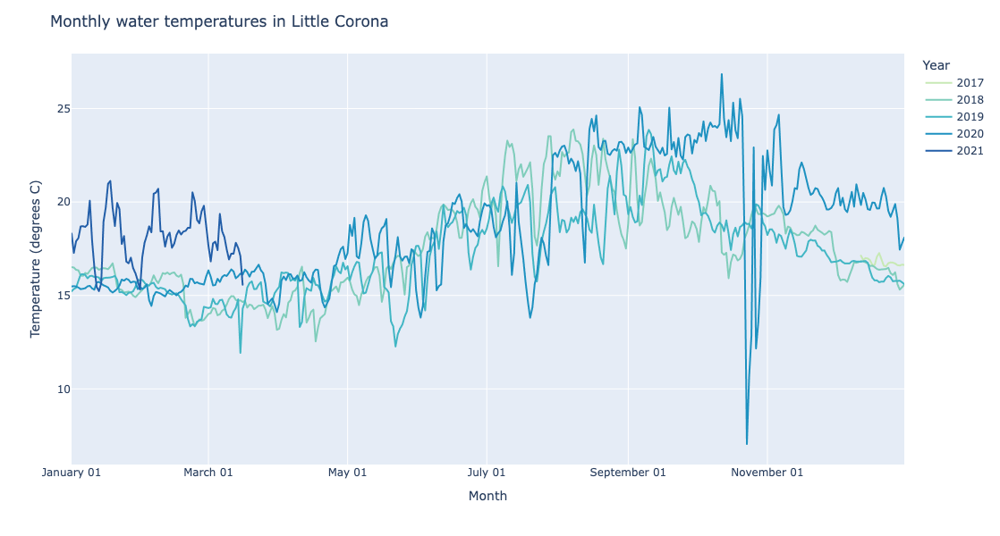

In [5]:
fig = graphs.line_overlaid_years(temp_data, site_name)
fig.show()

## OISST Data

NOAA provides a long term climate record call [OISST](https://www.ncei.noaa.gov/products/optimum-interpolation-sst) which stands for Optimum Interpolation Sea Surface Temperature. It incorporates observations from different platforms (satellites, ships, buoys and Argo floats) into a regular global grid, it's publicly available for download in netCDF4 file format. The spatial resolution of the grid is 0.25 degrees.
I've downloaded data from years 2017-2023 which are the range of years Reef Check seems to have ocean temperature data from.

Below is a sea surface temperature map from December 31, 2023, for reference. Land masses are masked out.

In [6]:
sst_dir = reef_check.get_sst_path(data_dir)
sst_path = os.path.join(sst_dir, '202312/oisst-avhrr-v02r01.20231231.nc')
sst, sst_lat, sst_lon = reef_check.read_oisst_file(sst_path, mask_out=True)
fig = graphs.oisst_map(sst, sst_lat, sst_lon)
fig.show()

For each date in the Reef Check dataset, we can find the closest matching geographic coordinates in the OISST dataset and compare Reef Check temperatures (which are usually at a depth of 12.5 meters below sea level) and the OISST sea surface temperatures.

In [7]:
fig = graphs.line_consecutive_years(temp_data, site_name)
fig.show()

Temperatures are fairly well correlated with the Reef Check data showing somewhat larger variations. However the sea surface temperature does seem to be quite a bit lower than Reef Check data starting at the last half of 2020.

Compare sea surface temperatures to Reef Check temperatures at a different site: Pescadero.

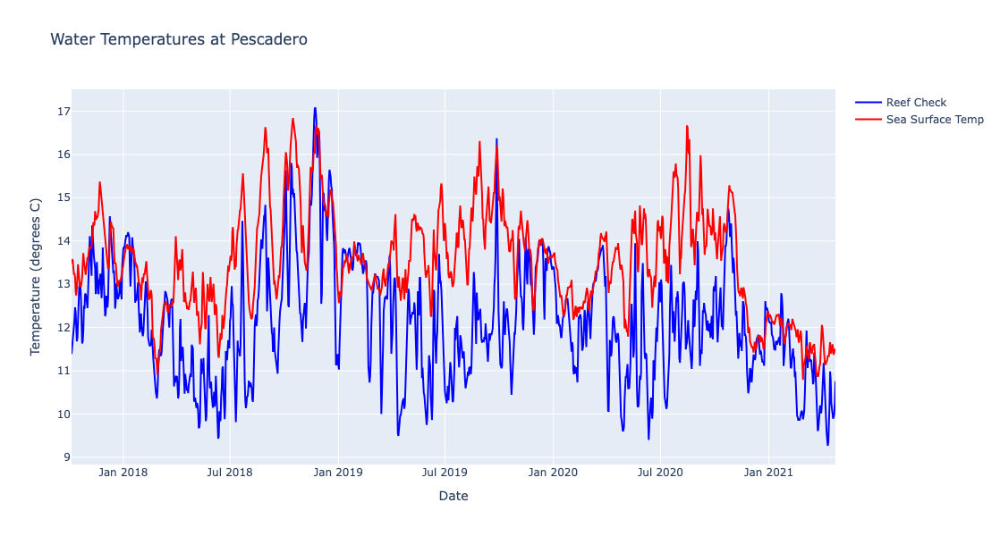

In [8]:
site_name = 'Pescadero'
temp_data = reef_check.site_temperature(data_dir, site_name, resample_rate='d')
fig = graphs.line_consecutive_years(temp_data, site_name)
fig.show()

It looks like perhaps sea surface temperatures are higher in the summers?

And one in Northern California for good measure: Fort Ross.

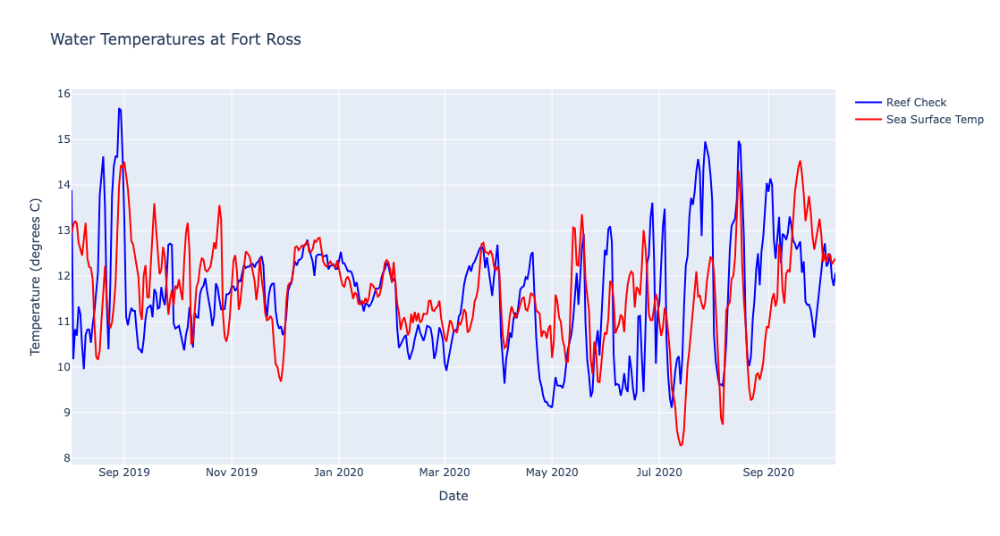

In [9]:
site_name = 'Fort Ross'
temp_data = reef_check.site_temperature(data_dir, site_name, resample_rate='d')
fig = graphs.line_consecutive_years(temp_data, site_name)
fig.show()